# **Air Pollution Classification**

**Create a normalized database (3NF).**

In [1]:
import sqlite3

# Connect to the database (or create if it doesn't exist)
conn = sqlite3.connect("Pollution_Data.db")
cur = conn.cursor()

# Drop existing tables if they exist
drop_table_queries = [
    "DROP TABLE IF EXISTS Environmental_Factors",
    "DROP TABLE IF EXISTS Pollutants",
    "DROP TABLE IF EXISTS Air_Quality"
]

for query in drop_table_queries:
    cur.execute(query)

# Create tables for 3NF schema
create_table_queries = [
    """
    CREATE TABLE IF NOT EXISTS Environmental_Factors (
        factor_id INTEGER PRIMARY KEY AUTOINCREMENT NOT NULL,
        temperature FLOAT NOT NULL,
        humidity FLOAT NOT NULL,
        proximity_to_industrial_areas FLOAT NOT NULL,
        population_density FLOAT NOT NULL
    )
    """,
    """
    CREATE TABLE IF NOT EXISTS Pollutants (
        pollutant_id INTEGER PRIMARY KEY AUTOINCREMENT NOT NULL,
        pm2_5 FLOAT NOT NULL,
        pm10 FLOAT NOT NULL,
        no2 FLOAT NOT NULL,
        so2 FLOAT NOT NULL,
        co FLOAT NOT NULL
    )
    """,
    """
    CREATE TABLE IF NOT EXISTS Air_Quality (
        quality_id INTEGER PRIMARY KEY AUTOINCREMENT NOT NULL,
        factor_id INTEGER NOT NULL,
        pollutant_id INTEGER NOT NULL,
        air_quality_label VARCHAR(50) NOT NULL,
        FOREIGN KEY (factor_id) REFERENCES Environmental_Factors(factor_id),
        FOREIGN KEY (pollutant_id) REFERENCES Pollutants(pollutant_id)
    )
    """
]

for query in create_table_queries:
    cur.execute(query)

# Commit the changes to the database
conn.commit()

print("3NF schema tables for pollution data created successfully.")

# Close the connection
cur.close()
conn.close()

3NF schema tables for pollution data created successfully.


**SQL join statement to fetch data from the database and into Pandas DataFrame.**

In [2]:
import sqlite3
import csv

# Connect to the database (or create if it doesn't exist)
conn = sqlite3.connect("Pollution_Data.db")
cur = conn.cursor()

# Define SQL statements to drop tables if they exist
drop_table_queries = [
    "DROP TABLE IF EXISTS Environmental_Factors",
    "DROP TABLE IF EXISTS Pollutants",
    "DROP TABLE IF EXISTS Air_Quality"
]

# Execute drop table queries
for query in drop_table_queries:
    cur.execute(query)

# Define SQL statements to create tables
create_table_queries = [
    """
    CREATE TABLE IF NOT EXISTS Environmental_Factors (
        factor_id INTEGER PRIMARY KEY AUTOINCREMENT NOT NULL,
        temperature FLOAT NOT NULL,
        humidity FLOAT NOT NULL,
        proximity_to_industrial_areas FLOAT NOT NULL,
        population_density FLOAT NOT NULL
    )
    """,
    """
    CREATE TABLE IF NOT EXISTS Pollutants (
        pollutant_id INTEGER PRIMARY KEY AUTOINCREMENT NOT NULL,
        pm2_5 FLOAT NOT NULL,
        pm10 FLOAT NOT NULL,
        no2 FLOAT NOT NULL,
        so2 FLOAT NOT NULL,
        co FLOAT NOT NULL
    )
    """,
    """
    CREATE TABLE IF NOT EXISTS Air_Quality (
        quality_id INTEGER PRIMARY KEY AUTOINCREMENT NOT NULL,
        factor_id INTEGER NOT NULL,
        pollutant_id INTEGER NOT NULL,
        air_quality_label VARCHAR(50) NOT NULL,
        FOREIGN KEY (factor_id) REFERENCES Environmental_Factors(factor_id),
        FOREIGN KEY (pollutant_id) REFERENCES Pollutants(pollutant_id)
    )
    """
]

# Execute table creation queries
for query in create_table_queries:
    cur.execute(query)

# Commit table creation
conn.commit()

# Read the CSV file and adapt to column names dynamically
with open('updated_pollution_dataset.csv', 'r', encoding='utf-8') as file:
    reader = csv.DictReader(file)
    headers = reader.fieldnames  # Get column names dynamically

    # Map correct column names from CSV
    temperature_col = [col for col in headers if "Temperature" in col][0]
    humidity_col = [col for col in headers if "Humidity" in col][0]
    proximity_col = [col for col in headers if "Proximity_to_Industrial_Areas" in col][0]
    population_col = [col for col in headers if "Population_Density" in col][0]
    pm2_5_col = [col for col in headers if "PM2.5" in col][0]
    pm10_col = [col for col in headers if "PM10" in col][0]
    no2_col = [col for col in headers if "NO2" in col][0]
    so2_col = [col for col in headers if "SO2" in col][0]
    co_col = [col for col in headers if "CO" in col][0]
    air_quality_col = [col for col in headers if "Air Quality" in col][0]

    environmental_factors_set = set()
    pollutants_set = set()
    air_quality_data = []

    for row in reader:
        temperature = float(row[temperature_col])
        humidity = float(row[humidity_col])
        proximity_to_industrial_areas = float(row[proximity_col])
        population_density = float(row[population_col])
        pm2_5 = float(row[pm2_5_col])
        pm10 = float(row[pm10_col])
        no2 = float(row[no2_col])
        so2 = float(row[so2_col])
        co = float(row[co_col])
        air_quality_label = row[air_quality_col]

        environmental_factors_set.add((temperature, humidity, proximity_to_industrial_areas, population_density))
        pollutants_set.add((pm2_5, pm10, no2, so2, co))
        air_quality_data.append((temperature, humidity, proximity_to_industrial_areas, population_density, pm2_5, pm10, no2, so2, co, air_quality_label))

    # Insert unique environmental factors
    cur.executemany("""
        INSERT INTO Environmental_Factors (temperature, humidity, proximity_to_industrial_areas, population_density)
        VALUES (?, ?, ?, ?)
    """, list(environmental_factors_set))

    # Insert unique pollutants
    cur.executemany("""
        INSERT INTO Pollutants (pm2_5, pm10, no2, so2, co)
        VALUES (?, ?, ?, ?, ?)
    """, list(pollutants_set))

    # Insert into Air_Quality table
    for data in air_quality_data:
        cur.execute("""
            INSERT INTO Air_Quality (factor_id, pollutant_id, air_quality_label)
            VALUES (
                (SELECT factor_id FROM Environmental_Factors WHERE temperature = ? AND humidity = ? AND proximity_to_industrial_areas = ? AND population_density = ?),
                (SELECT pollutant_id FROM Pollutants WHERE pm2_5 = ? AND pm10 = ? AND no2 = ? AND so2 = ? AND co = ?),
                ?
            )
        """, data)

# Commit data insertion and close connection
conn.commit()
cur.close()
conn.close()

print("Table creation and data insertion for pollution data completed.")

Table creation and data insertion for pollution data completed.


In [3]:
import pandas as pd
import sqlite3

# Connect to the SQLite database
conn = sqlite3.connect('Pollution_Data.db')

# Write SQL query using joins to fetch data
query = """
SELECT aq.quality_id,
       ef.temperature,
       ef.humidity,
       ef.proximity_to_industrial_areas,
       ef.population_density,
       p.pm2_5,
       p.pm10,
       p.no2,
       p.so2,
       p.co,
       aq.air_quality_label
FROM Air_Quality aq
LEFT JOIN Environmental_Factors ef ON aq.factor_id = ef.factor_id
LEFT JOIN Pollutants p ON aq.pollutant_id = p.pollutant_id
"""

try:
    # Fetch data into Pandas DataFrame
    df = pd.read_sql_query(query, conn)

    # Display the DataFrame to check if it contains data
    print(df.head())  # Display the first few rows
    print(df.shape)  # Display the shape of the DataFrame (rows x columns)

    # Check for null and missing values
    print('Null and Missing values:')
    null_values_original = df.isnull() | (df == 'None')
    missing_values_original = df.isna().sum()
    print(null_values_original)
    print(missing_values_original)

except Exception as e:
    print(f"An error occurred: {e}")

finally:
    # Close the database connection
    conn.close()

   quality_id  temperature  humidity  proximity_to_industrial_areas  \
0           1         29.8      59.1                            6.3   
1           2         28.3      75.6                            6.0   
2           3         23.1      74.7                            5.2   
3           4         27.1      39.1                           11.1   
4           5         26.5      70.7                           12.7   

   population_density  pm2_5  pm10   no2   so2    co air_quality_label  
0               319.0    5.2  17.9  18.9   9.2  1.72          Moderate  
1               611.0    2.3  12.2  30.8   9.7  1.64          Moderate  
2               619.0   26.7  33.8  24.4  12.6  1.63          Moderate  
3               551.0    6.1   6.3  13.5   5.3  1.15              Good  
4               303.0    6.9  16.0  21.9   5.6  1.01              Good  
(5000, 11)
Null and Missing values:
      quality_id  temperature  humidity  proximity_to_industrial_areas  \
0          False        F

**Explore the data to determine if you need to stratify it by some attribute when doing train/test split. Perform the train/test split**

In [4]:
import pandas as pd
from sklearn.model_selection import train_test_split
import sqlite3

# Connect to the SQLite database
conn = sqlite3.connect('Pollution_Data.db')

# Write SQL query using joins to fetch data
query = """
SELECT aq.quality_id,
       ef.temperature,
       ef.humidity,
       ef.proximity_to_industrial_areas,
       ef.population_density,
       p.pm2_5,
       p.pm10,
       p.no2,
       p.so2,
       p.co,
       aq.air_quality_label
FROM Air_Quality aq
LEFT JOIN Environmental_Factors ef ON aq.factor_id = ef.factor_id
LEFT JOIN Pollutants p ON aq.pollutant_id = p.pollutant_id
"""

# Fetch data into Pandas DataFrame
df = pd.read_sql_query(query, conn)
conn.close()

# Separate features (X) and target variable (y)
X = df.drop('air_quality_label', axis=1)  # Features
y = df['air_quality_label']  # Target variable

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Display the distribution of target labels in the training set
print(y_train.value_counts())

air_quality_label
Good         1600
Moderate     1200
Poor          800
Hazardous     400
Name: count, dtype: int64


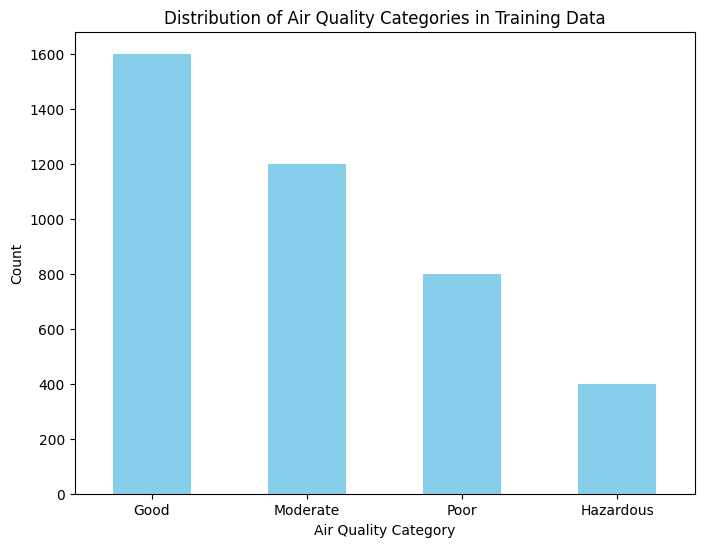

In [5]:
import matplotlib.pyplot as plt

# Count the occurrences of each air quality category in the training data
air_quality_counts = y_train.value_counts()

# Plot the distribution
plt.figure(figsize=(8, 6))
air_quality_counts.plot(kind='bar', color='skyblue')
plt.title('Distribution of Air Quality Categories in Training Data')
plt.xlabel('Air Quality Category')
plt.ylabel('Count')
plt.xticks(rotation=0)  # Rotate x-axis labels if needed
plt.show()

In [6]:
from sklearn.model_selection import train_test_split

# Assuming df is your DataFrame and 'air_quality_label' is the target column
# Separate features (X) and target variable (y)
X = df.drop('air_quality_label', axis=1)
y = df['air_quality_label']

# Perform train/test split with stratification
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Display the shape of the training and testing sets
print("Training data shape:", X_train.shape, y_train.shape)
print("Testing data shape:", X_test.shape, y_test.shape)

Training data shape: (4000, 10) (4000,)
Testing data shape: (1000, 10) (1000,)


In [7]:
import pandas as pd
from sklearn.model_selection import train_test_split

# Assuming df is your DataFrame containing the data

# Calculate class distribution in the original dataset
class_distribution_original = df['air_quality_label'].value_counts()
print("Original Class Distribution:")
print(class_distribution_original)

# Perform train/test split with stratification
X_train, X_test, y_train, y_test = train_test_split(
    df.drop('air_quality_label', axis=1),
    df['air_quality_label'],
    test_size=0.2,
    stratify=df['air_quality_label'],
    random_state=42
)

# Calculate class distribution in the training set
class_distribution_train = y_train.value_counts()
print("\nClass Distribution in Training Set:")
print(class_distribution_train)

# Calculate class distribution in the testing set
class_distribution_test = y_test.value_counts()
print("\nClass Distribution in Testing Set:")
print(class_distribution_test)

# Display the first few rows of the dataset to confirm structure
print(df.head())

Original Class Distribution:
air_quality_label
Good         2000
Moderate     1500
Poor         1000
Hazardous     500
Name: count, dtype: int64

Class Distribution in Training Set:
air_quality_label
Good         1600
Moderate     1200
Poor          800
Hazardous     400
Name: count, dtype: int64

Class Distribution in Testing Set:
air_quality_label
Good         400
Moderate     300
Poor         200
Hazardous    100
Name: count, dtype: int64
   quality_id  temperature  humidity  proximity_to_industrial_areas  \
0           1         29.8      59.1                            6.3   
1           2         28.3      75.6                            6.0   
2           3         23.1      74.7                            5.2   
3           4         27.1      39.1                           11.1   
4           5         26.5      70.7                           12.7   

   population_density  pm2_5  pm10   no2   so2    co air_quality_label  
0               319.0    5.2  17.9  18.9   9.2  1.72  

In [8]:
# Identify duplicate column names in the DataFrame
duplicate_labels = df.columns[df.columns.duplicated()]

# Print the duplicate column names
print("Duplicate Columns:")
print(duplicate_labels)

Duplicate Columns:
Index([], dtype='object')


In [9]:
!pip install ydata-profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.9/390.9 kB 22.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 21.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 26.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 50.4 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=78a0920c04eb1303450914979adcb0e4c62b2114c7296e46b4cb16a778b04de0
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


**Explore the data using yprofile and correlation matrix. Make observations about features, distributions, capped values, and missing values. Create a list of data cleanup tasks.**

In [10]:
import pandas as pd
from sklearn.model_selection import train_test_split
from ydata_profiling import ProfileReport

# Check for duplicate labels in the DataFrame
duplicate_labels = df.columns.duplicated()
print("Duplicate Labels:")
print(duplicate_labels)

# Drop duplicates if necessary
df_no_duplicates = df.loc[:, ~df.columns.duplicated()]

# Perform train/test split with stratification on the DataFrame without duplicates
X_train, X_test, y_train, y_test = train_test_split(
    df_no_duplicates.drop('air_quality_label', axis=1),
    df_no_duplicates['air_quality_label'],
    test_size=0.2,
    stratify=df_no_duplicates['air_quality_label'],
    random_state=42
)

# Generate a profile report for the training data without duplicates
profile = ProfileReport(X_train, title="Pollution Dataset Training Data Report", explorative=True)

# Display the report in a Jupyter Notebook
profile.to_notebook_iframe()

Duplicate Labels:
[False False False False False False False False False False False]


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [11]:
!pip install --upgrade pandas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 58.9 MB/s eta 0:00:00
  Attempting uninstall: pandas
    Found existing installation: pandas 2.2.2
    Uninstalling pandas-2.2.2:
      Successfully uninstalled pandas-2.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.10.1 requires pandas<2.2.3dev0,>=2.0, but you have pandas 2.2.3 which is incompatible.
google-colab 1.0.0 requires pandas==2.2.2, but you have pandas 2.2.3 which is incompatible.


In [12]:
import pandas as pd

# Assuming df is your DataFrame containing the pollution data

# Get all columns except the target column ('air_quality_label')
all_cols_except_target = df.columns[df.columns != 'air_quality_label']

# Identify categorical columns based on their data types
categorical_cols = df[all_cols_except_target].select_dtypes(include='object').columns.tolist()

# Identify numerical columns based on their data types
numerical_cols = df[all_cols_except_target].select_dtypes(include=['int64', 'float64']).columns.tolist()

# Display the identified categorical and numerical columns
print("Categorical Columns:")
print(categorical_cols)

print("\nDataFrame Info:")
print(df.info())  # To check DataFrame structure and types

print("\nNumerical Columns:")
print(numerical_cols)

Categorical Columns:
[]

DataFrame Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 11 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   quality_id                     5000 non-null   int64  
 1   temperature                    5000 non-null   float64
 2   humidity                       5000 non-null   float64
 3   proximity_to_industrial_areas  5000 non-null   float64
 4   population_density             5000 non-null   float64
 5   pm2_5                          5000 non-null   float64
 6   pm10                           5000 non-null   float64
 7   no2                            5000 non-null   float64
 8   so2                            5000 non-null   float64
 9   co                             5000 non-null   float64
 10  air_quality_label              5000 non-null   object 
dtypes: float64(9), int64(1), object(1)
memory usage: 429.8+ KB
None

Nu

In [13]:
# Categorize data into categorical and numerical columns
categorical_cols = ['proximity_to_industrial_areas', 'population_density']  # Add other categorical columns if applicable
numerical_cols = ['temperature', 'humidity', 'pm2_5', 'pm10', 'no2', 'so2', 'co']  # Numerical features
target_col = ['air_quality_label']  # Target column

# Identify null and missing values in the original dataset
null_values_original = df.isnull() | (df == 'None')
missing_values_original = df.isna().sum()

# Ensure correct data types
df[categorical_cols] = df[categorical_cols].astype('object')

# Display results
print("Categorical Columns:")
print(df[categorical_cols].head())

print("\nNumerical Columns:")
print(df[numerical_cols].head())

print("\nNull Values in Original Dataset:")
print(null_values_original)

print("\nMissing Values in Original Dataset:")
print(missing_values_original)

Categorical Columns:
  proximity_to_industrial_areas population_density
0                           6.3              319.0
1                           6.0              611.0
2                           5.2              619.0
3                          11.1              551.0
4                          12.7              303.0

Numerical Columns:
   temperature  humidity  pm2_5  pm10   no2   so2    co
0         29.8      59.1    5.2  17.9  18.9   9.2  1.72
1         28.3      75.6    2.3  12.2  30.8   9.7  1.64
2         23.1      74.7   26.7  33.8  24.4  12.6  1.63
3         27.1      39.1    6.1   6.3  13.5   5.3  1.15
4         26.5      70.7    6.9  16.0  21.9   5.6  1.01

Null Values in Original Dataset:
      quality_id  temperature  humidity  proximity_to_industrial_areas  \
0          False        False     False                          False   
1          False        False     False                          False   
2          False        False     False                      

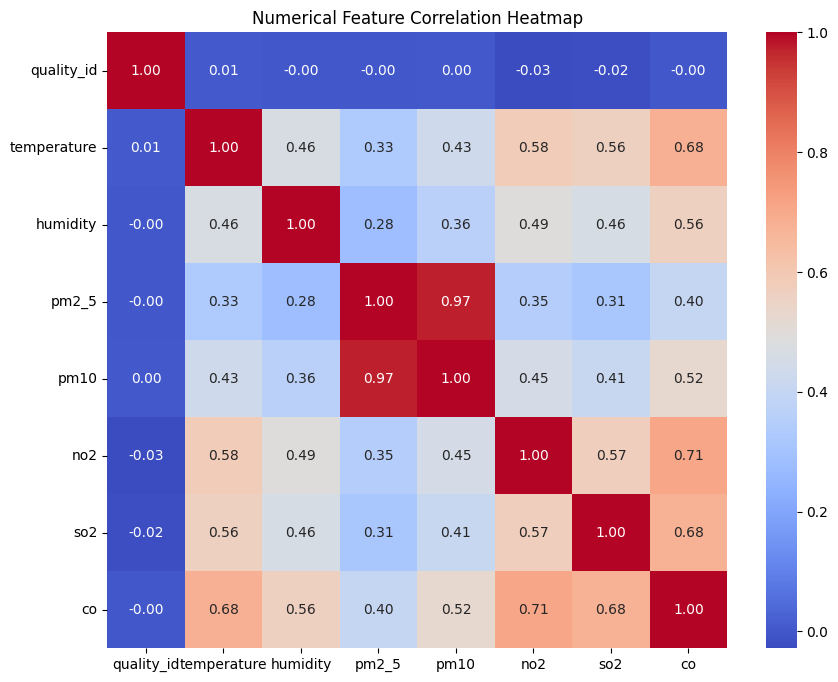

Pair Plots


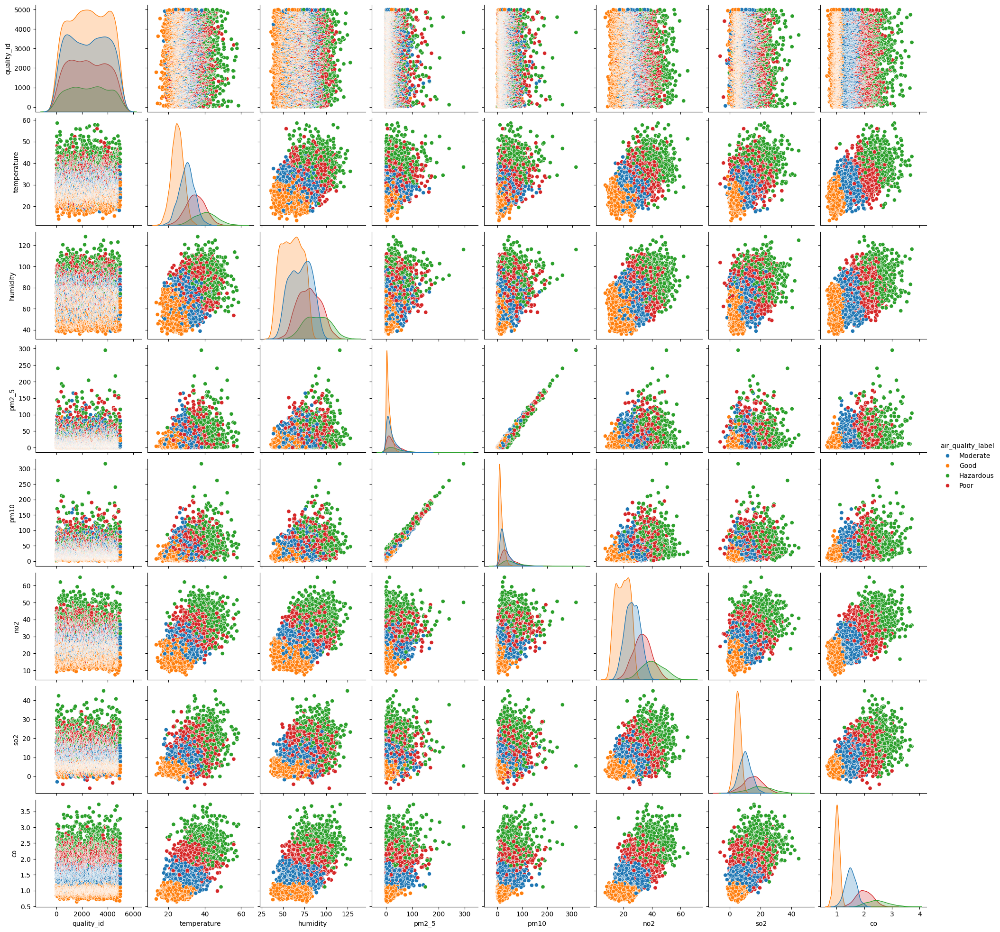

air_quality_label
Good         2000
Moderate     1500
Poor         1000
Hazardous     500
Name: count, dtype: int64


In [14]:
import seaborn as sns
import matplotlib.pyplot as plt

# Get all columns except the target column ('air_quality_label')
all_cols_except_target = df.columns[df.columns != 'air_quality_label']

# Identify categorical columns based on their data types
categorical_cols = df[all_cols_except_target].select_dtypes(include='object').columns.tolist()

# Identify numerical columns based on their data types
numerical_cols = df[all_cols_except_target].select_dtypes(include=['int64', 'float64']).columns.tolist()

# Calculate correlation matrix for numerical columns
corr_matrix = X_train[numerical_cols].corr()

# Plot feature correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Numerical Feature Correlation Heatmap")
plt.show()

# Pair Plots
print("\033[1mPair Plots\033[0m")
sns.pairplot(df[numerical_cols + ['air_quality_label']], hue='air_quality_label', diag_kind='kde')
plt.show()

# Check the distribution of air quality categories
print(df_no_duplicates['air_quality_label'].value_counts())

Observations from the Heatmap:

1. **Strong Correlation between PM2.5 and PM10**:
   - There is a very high positive correlation (close to 1.0) between `pm2_5` and `pm10`. This indicates that these two features are closely related, likely measuring similar pollutant concentrations.

2. **High Correlation between NO2 and CO**:
   - `no2` and `co` have a strong positive correlation (around 0.71). This suggests that higher levels of nitrogen dioxide are often accompanied by higher levels of carbon monoxide, likely due to shared sources such as vehicle emissions or industrial activities.

3. **Moderate Correlation between Temperature and CO**:
   - There is a moderate positive correlation (around 0.68) between `temperature` and `co`. This could suggest that higher temperatures might be associated with increased carbon monoxide levels, potentially due to enhanced photochemical reactions or specific seasonal patterns.

4. **Moderate Correlation between Temperature and NO2**:
   - The correlation between `temperature` and `no2` is around 0.58, indicating a moderate relationship. This could reflect seasonal variations or temperature-dependent activities that release NO2.

5. **Moderate Correlation of Humidity with Pollutants**:
   - Humidity shows moderate correlations with pollutants like `no2`, `so2`, and `co`. This suggests that humidity might play a role in pollutant behavior or dispersion.

6. **Independent Nature of Quality ID**:
   - The `quality_id` feature shows very low or no correlation with other features. This indicates it might be a categorical identifier or unrelated to numerical variables in the dataset.

7. **SO2 and CO Correlation**:
   - `so2` and `co` exhibit a moderately high positive correlation (around 0.68). This could point to shared pollution sources or environmental conditions that promote their coexistence.

8. **PM2.5 and NO2**:
   - There is a weaker correlation between `pm2_5` and `no2` compared to `pm2_5` and `pm10`, suggesting distinct sources or atmospheric interactions for these pollutants.

Implications:
- Features with strong correlations (e.g., `pm2_5` and `pm10`) might be redundant and could potentially be combined or one of them dropped to simplify the model.
- The correlations highlight relationships that might be explored further to understand environmental and anthropogenic interactions.
- Variables like `temperature` and `humidity` might influence pollution levels and should be retained for modeling.


Summary statistics for quality_id:
count    5000.000000
mean     2500.500000
std      1443.520003
min         1.000000
25%      1250.750000
50%      2500.500000
75%      3750.250000
max      5000.000000



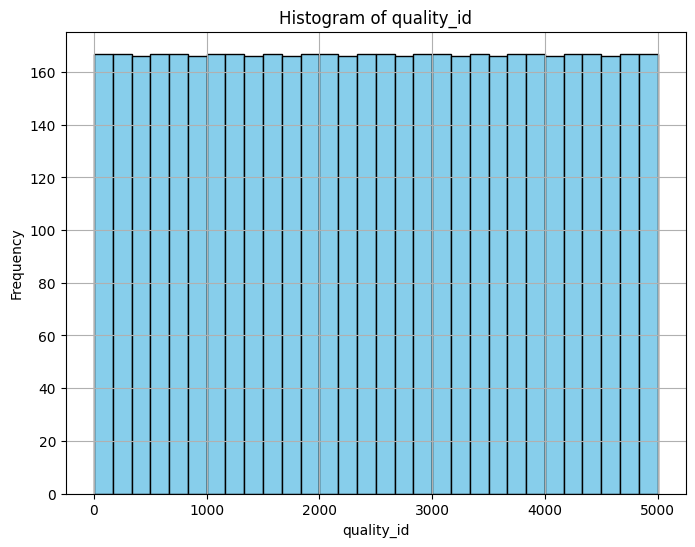

Summary statistics for temperature:
count    5000.000000
mean       30.029020
std         6.720661
min        13.400000
25%        25.100000
50%        29.000000
75%        34.000000
max        58.600000



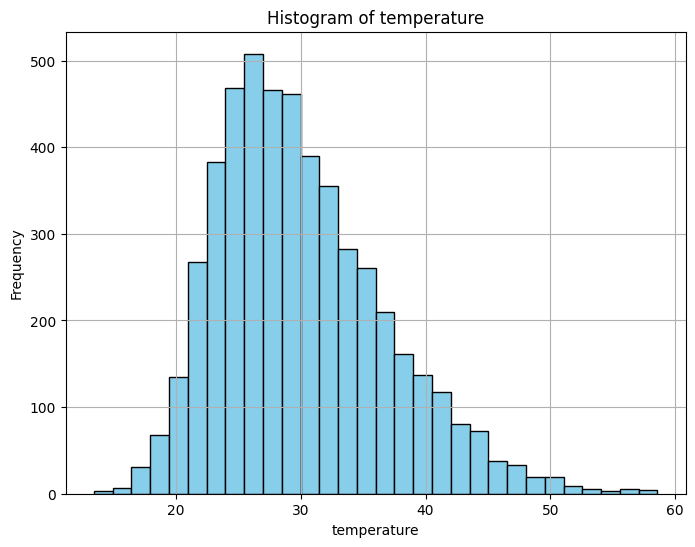

Summary statistics for humidity:
count    5000.000000
mean       70.056120
std        15.863577
min        36.000000
25%        58.300000
50%        69.800000
75%        80.300000
max       128.100000



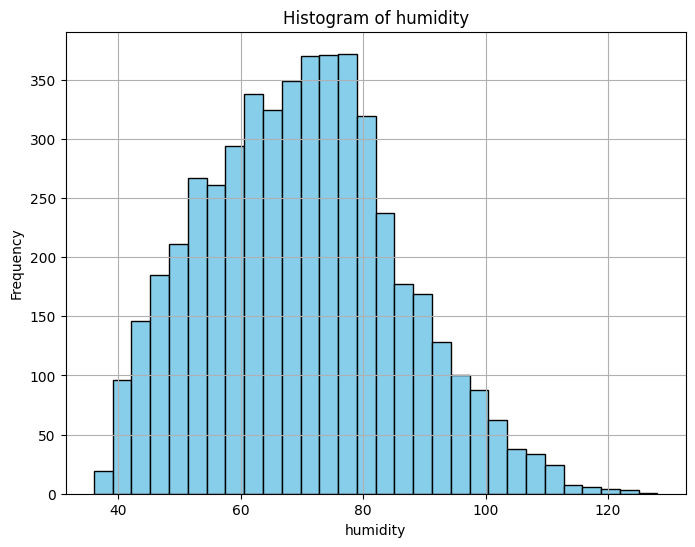

Summary statistics for pm2_5:
count    5000.000000
mean       20.142140
std        24.554546
min         0.000000
25%         4.600000
50%        12.000000
75%        26.100000
max       295.000000



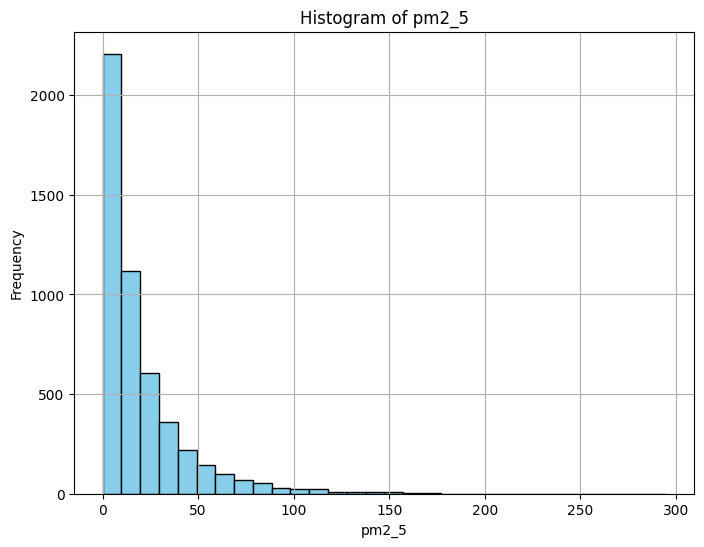

Summary statistics for pm10:
count    5000.000000
mean       30.218360
std        27.349199
min        -0.200000
25%        12.300000
50%        21.700000
75%        38.100000
max       315.800000



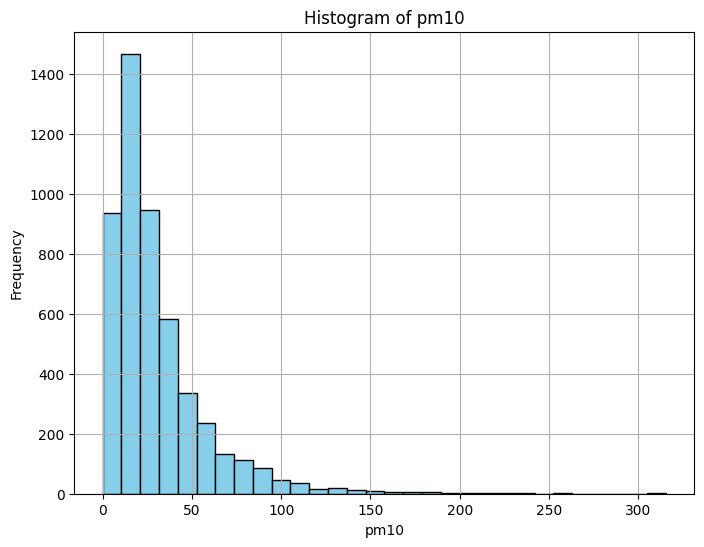

Summary statistics for no2:
count    5000.000000
mean       26.412100
std         8.895356
min         7.400000
25%        20.100000
50%        25.300000
75%        31.900000
max        64.900000



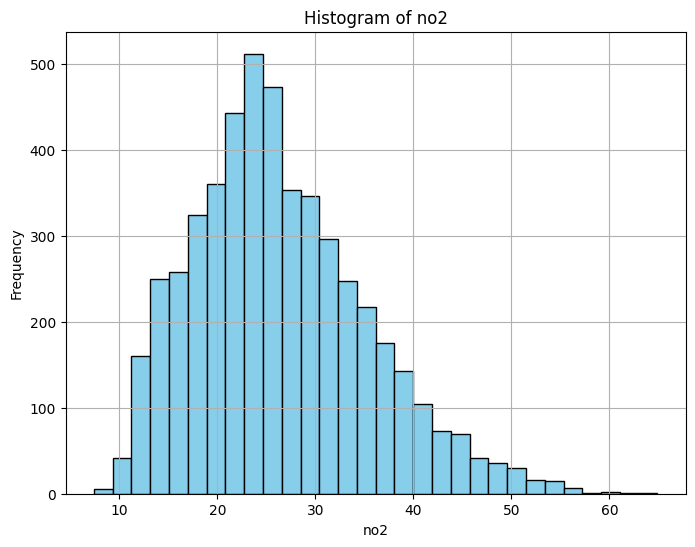

Summary statistics for so2:
count    5000.000000
mean       10.014820
std         6.750303
min        -6.200000
25%         5.100000
50%         8.000000
75%        13.725000
max        44.900000



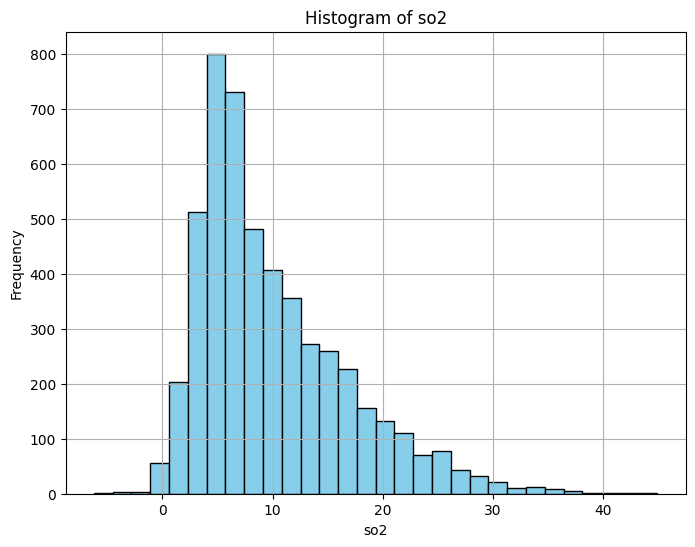

Summary statistics for co:
count    5000.000000
mean        1.500354
std         0.546027
min         0.650000
25%         1.030000
50%         1.410000
75%         1.840000
max         3.720000



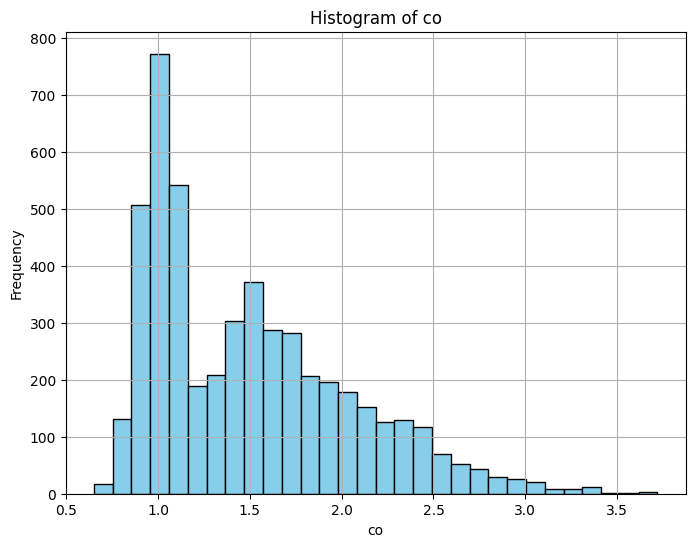

Mode for proximity_to_industrial_areas: 5.1

Frequency for proximity_to_industrial_areas:
proximity_to_industrial_areas
5.1     112
10.2    112
10.3    107
10.1    105
5.2      99
5.4      97
10.4     96
5.6      90
10.5     88
11.1     86
5.5      85
5.3      82
10.8     78
10.6     76
10.7     72
10.9     72
5.7      71
5.9      71
5.0      70
6.0      65
11.0     62
6.2      61
11.2     61
3.4      58
6.4      57
6.3      57
5.8      56
6.1      56
4.1      53
11.3     52
3.7      51
11.6     51
3.9      50
3.8      49
3.5      48
6.9      47
11.4     47
3.6      46
12.2     46
11.8     44
6.6      44
4.3      44
6.7      44
11.9     43
4.0      42
12.0     42
4.2      42
11.5     42
7.2      41
6.8      41
12.5     40
10.0     40
4.4      39
11.7     37
7.3      37
7.5      37
6.5      37
7.0      37
4.8      37
7.6      35
4.7      33
12.3     32
4.6      31
4.9      31
12.7     30
7.1      30
8.2      29
4.5      29
2.6      28
12.1     28
9.0      28
2.8      26
13.7     26
12.6

<ipython-input-15-0a30e64272dd>:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='pastel')


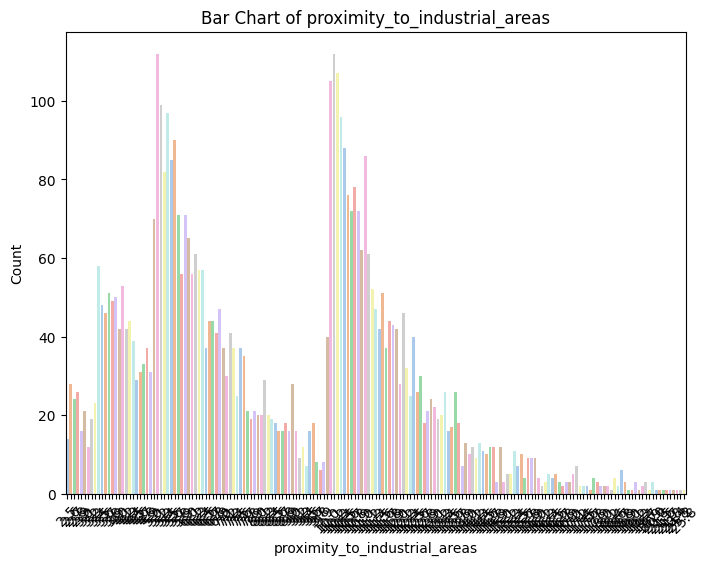

Mode for population_density: 494.0

Frequency for population_density:
population_density
494.0    24
454.0    23
543.0    22
471.0    20
501.0    20
538.0    20
511.0    19
438.0    19
506.0    19
485.0    19
444.0    18
458.0    18
571.0    18
581.0    18
516.0    18
577.0    18
373.0    17
569.0    17
484.0    17
500.0    17
488.0    17
451.0    17
450.0    17
582.0    16
579.0    16
531.0    16
576.0    16
384.0    16
406.0    16
333.0    16
593.0    15
509.0    15
326.0    15
600.0    15
591.0    15
407.0    15
365.0    15
623.0    15
405.0    15
505.0    15
388.0    15
481.0    15
565.0    15
586.0    15
448.0    15
473.0    14
566.0    14
589.0    14
432.0    14
527.0    14
549.0    14
463.0    14
317.0    14
376.0    14
555.0    14
449.0    14
592.0    14
359.0    14
437.0    14
410.0    14
428.0    14
425.0    14
541.0    14
379.0    14
562.0    14
512.0    14
530.0    14
609.0    14
542.0    13
630.0    13
539.0    13
492.0    13
430.0    13
390.0    13
493.0    13
574.0    13

<ipython-input-15-0a30e64272dd>:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='pastel')


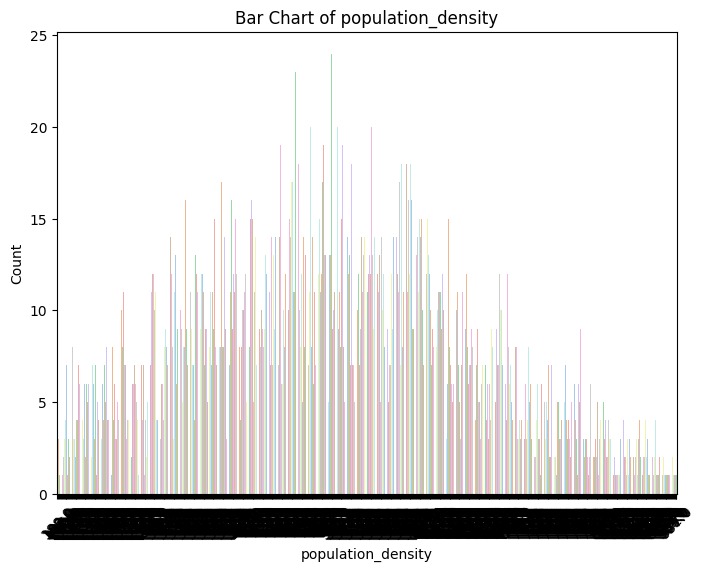

Mode for air_quality_label: Good

Frequency for air_quality_label:
air_quality_label
Good         2000
Moderate     1500
Poor         1000
Hazardous     500



<ipython-input-15-0a30e64272dd>:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=df, palette='pastel')


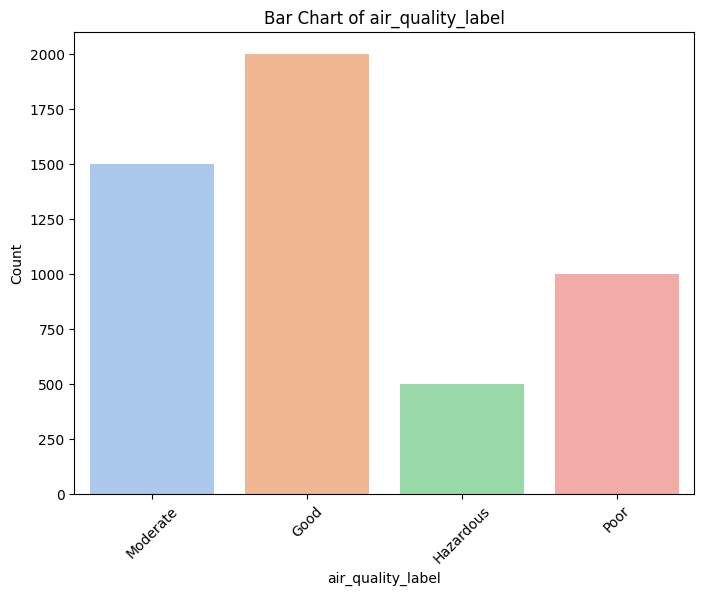

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Separate numerical and categorical features
numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns
categorical_cols = df.select_dtypes(include=['object']).columns

# Examine distribution of numerical features and plot histograms
for col in numerical_cols:
    # Summary statistics for numerical features
    stats = df[col].describe().to_string()
    print(f"Summary statistics for {col}:\n{stats}\n")

    # Histogram for numerical features
    plt.figure(figsize=(8, 6))
    plt.hist(df[col], bins=30, color='skyblue', edgecolor='black')
    plt.title(f'Histogram of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

# If categorical columns exist in the pollution dataset, examine their distribution
if not categorical_cols.empty:
    for col in categorical_cols:
        # Mode and frequency for categorical features
        mode_value = df[col].mode().values[0]
        frequency = df[col].value_counts().to_string()
        print(f"Mode for {col}: {mode_value}\n")
        print(f"Frequency for {col}:\n{frequency}\n")

        # Bar chart for categorical features
        plt.figure(figsize=(8, 6))
        sns.countplot(x=col, data=df, palette='pastel')
        plt.title(f'Bar Chart of {col}')
        plt.xlabel(col)
        plt.ylabel('Count')
        plt.xticks(rotation=45)
        plt.show()
else:
    print("No categorical columns found in the pollution dataset.")

### Overall Observations:

1. **Data Quality Issues:**
   - Negative values in `pm10` and `so2` are invalid and need correction or removal.
   - Humidity values exceeding 100% should be verified or treated as anomalies.

2. **Imbalances in Air Quality:**
   - `air_quality_label` distribution highlights class imbalance, especially for the `Hazardous` category, which has significantly fewer samples.

3. **Correlation with Industrial Proximity:**
   - `proximity_to_industrial_areas` and pollution metrics like `pm2_5`, `pm10`, and `no2` may have strong correlations and need further exploration.

4. **Outlier Checks:**
   - Temperature, `pm2_5`, and `pm10` exhibit extreme values and might require outlier treatment.

5. **Categorical Columns Validation:**
   - Ensure categories in `proximity_to_industrial_areas` and `population_density` are meaningful and consistent.

In [16]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
import pandas as pd
import numpy as np

class PollutionDataPreprocessor:
    def __init__(self):
        self.imputer = SimpleImputer(strategy='most_frequent')
        self.scaler = StandardScaler()
        self.onehot_encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore')

    def transform(self, df, categorical_cols, numerical_cols):
        # Handle missing values for categorical columns using SimpleImputer with mode
        imputed_categorical = self.imputer.fit_transform(df[categorical_cols])
        df_imputed_categorical = pd.DataFrame(imputed_categorical, columns=categorical_cols)

        # Perform One-Hot Encoding for imputed categorical columns
        encoded_categorical = self.onehot_encoder.fit_transform(df_imputed_categorical)
        encoded_categorical_df = pd.DataFrame(
            encoded_categorical,
            columns=self.onehot_encoder.get_feature_names_out(categorical_cols)
        )

        # Handle missing values for numerical columns using SimpleImputer with mean
        imputer_num = SimpleImputer(strategy='mean')
        imputed_numerical = imputer_num.fit_transform(df[numerical_cols])
        df_imputed_numerical = pd.DataFrame(imputed_numerical, columns=numerical_cols)

        # Apply log transformation to numerical columns (excluding those that cannot be log-transformed)
        for col in numerical_cols:
            if (df_imputed_numerical[col] <= 0).any():
                continue  # Skip columns with non-positive values
            df_imputed_numerical[col] = np.log1p(df_imputed_numerical[col])

        # Scale numerical columns
        scaled_numerical = self.scaler.fit_transform(df_imputed_numerical)
        scaled_numerical_df = pd.DataFrame(scaled_numerical, columns=numerical_cols)

        # Concatenate processed categorical and numerical data
        df_processed = pd.concat([scaled_numerical_df, encoded_categorical_df], axis=1)

        return df_processed

In [17]:
# Check for missing values in the cleaned dataset
missing_values = df.isnull().sum()

# Display missing values
print("Missing values per column:")
print(missing_values)

Missing values per column:
quality_id                       0
temperature                      0
humidity                         0
proximity_to_industrial_areas    0
population_density               0
pm2_5                            0
pm10                             0
no2                              0
so2                              0
co                               0
air_quality_label                0
dtype: int64


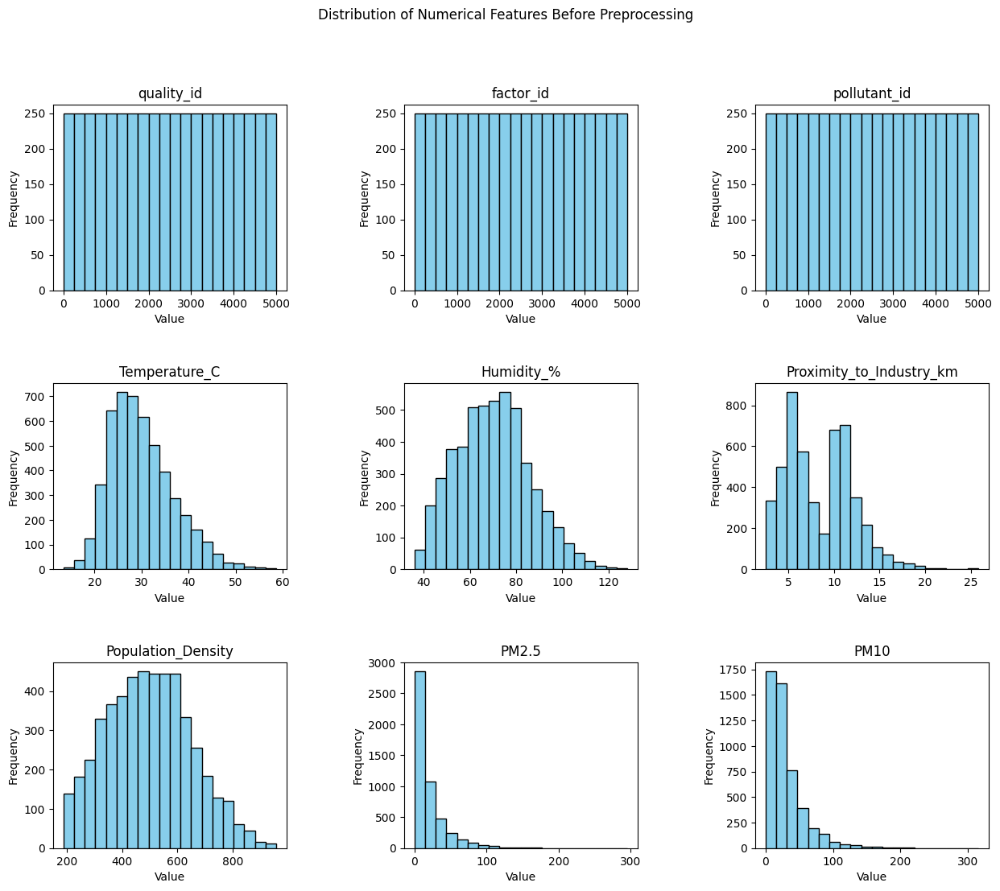

Shapiro-Wilk Test for quality_id: Statistic=0.9549060193583592, p-value=9.41267774906087e-37
Shapiro-Wilk Test for factor_id: Statistic=0.9549060193583575, p-value=9.412677749049159e-37
Shapiro-Wilk Test for pollutant_id: Statistic=0.9549060193583582, p-value=9.412677749053602e-37
Shapiro-Wilk Test for Temperature_C: Statistic=0.9653024059902227, p-value=4.578445897935196e-33
Shapiro-Wilk Test for Humidity_%: Statistic=0.9896238913339267, p-value=1.0300530871704803e-18
Shapiro-Wilk Test for Proximity_to_Industry_km: Statistic=0.953046999752712, p-value=2.439059015142663e-37
Shapiro-Wilk Test for Population_Density: Statistic=0.989982690755052, p-value=2.3256665131086076e-18
Shapiro-Wilk Test for PM2.5: Statistic=0.7152623835002103, p-value=1.899768552150622e-68
Shapiro-Wilk Test for PM10: Statistic=0.7689311442593205, p-value=2.3928038249847136e-64
Shapiro-Wilk Test for NO2: Statistic=0.9722456103018661, p-value=4.37444726050148e-30
Shapiro-Wilk Test for SO2: Statistic=0.91191924615770

In [18]:
import sqlite3
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import shapiro

# Connect to the SQLite database
conn = sqlite3.connect("Pollution_Data.db")

# Load data from the database into pandas DataFrames
environmental_factors = pd.read_sql_query("SELECT * FROM Environmental_Factors", conn)
pollutants = pd.read_sql_query("SELECT * FROM Pollutants", conn)
air_quality = pd.read_sql_query("SELECT * FROM Air_Quality", conn)

# Merge data into a single DataFrame
df = pd.merge(
    pd.merge(air_quality, environmental_factors, on="factor_id"),
    pollutants,
    on="pollutant_id",
)

# Step 1: Rename Columns
rename_columns = {
    "temperature": "Temperature_C",
    "humidity": "Humidity_%",
    "proximity_to_industrial_areas": "Proximity_to_Industry_km",
    "population_density": "Population_Density",
    "pm2_5": "PM2.5",
    "pm10": "PM10",
    "no2": "NO2",
    "so2": "SO2",
    "co": "CO",
    "air_quality_label": "Air_Quality"
}
df.rename(columns=rename_columns, inplace=True)

# Check for normal distribution before preprocessing
num_cols = df.select_dtypes(include=np.number).columns

# Create subplots with a spaced-out layout
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(15, 12))
fig.subplots_adjust(hspace=0.5, wspace=0.5)  # Adjust spacing between subplots

# Plot histograms of numerical features before preprocessing
for i, ax in enumerate(axes.flat):
    if i < len(num_cols):
        ax.hist(df[num_cols[i]], bins=20, color='skyblue', edgecolor='black')
        ax.set_title(num_cols[i])
        ax.set_xlabel('Value')
        ax.set_ylabel('Frequency')

# Display the plot
plt.suptitle('Distribution of Numerical Features Before Preprocessing')
plt.show()

# Perform statistical tests for normality
for col in num_cols:
    stat, p = shapiro(df[col])
    print(f"Shapiro-Wilk Test for {col}: Statistic={stat}, p-value={p}")

# Close the database connection
conn.close()

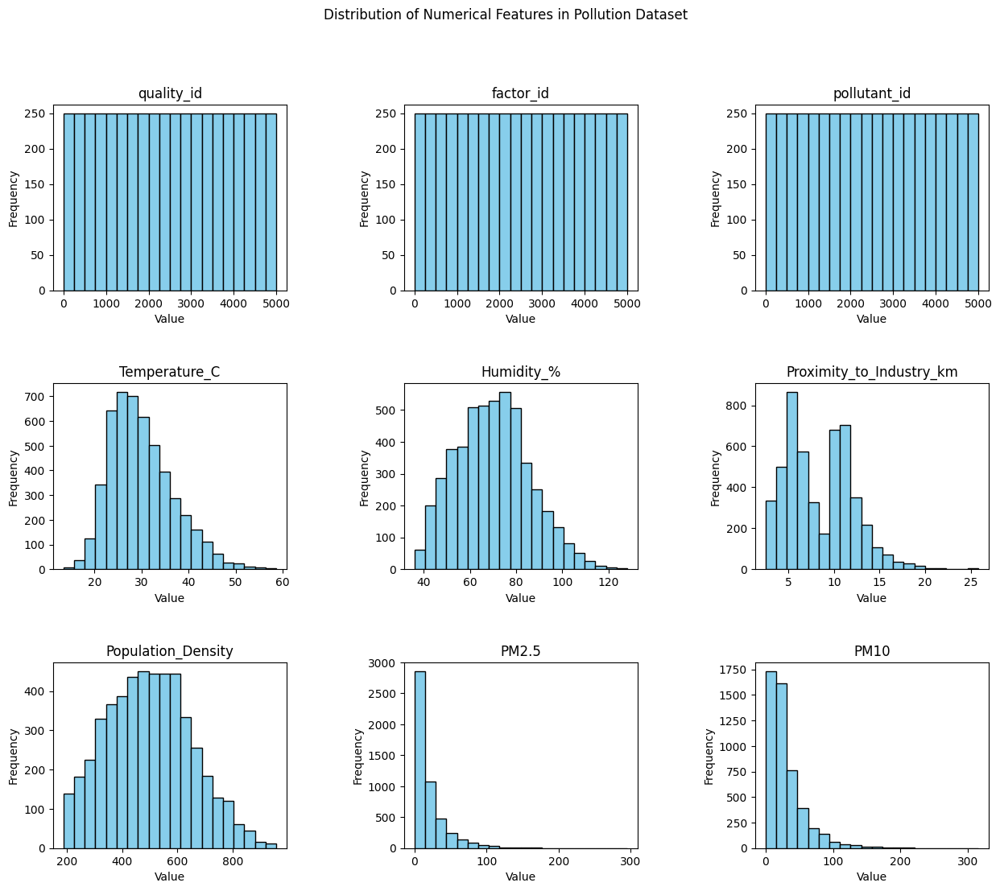

Shapiro-Wilk Test Results:
quality_id: Statistic=0.9549, p-value=0.0000
  quality_id does not follow a normal distribution.

factor_id: Statistic=0.9549, p-value=0.0000
  factor_id does not follow a normal distribution.

pollutant_id: Statistic=0.9549, p-value=0.0000
  pollutant_id does not follow a normal distribution.

Temperature_C: Statistic=0.9653, p-value=0.0000
  Temperature_C does not follow a normal distribution.

Humidity_%: Statistic=0.9896, p-value=0.0000
  Humidity_% does not follow a normal distribution.

Proximity_to_Industry_km: Statistic=0.9530, p-value=0.0000
  Proximity_to_Industry_km does not follow a normal distribution.

Population_Density: Statistic=0.9900, p-value=0.0000
  Population_Density does not follow a normal distribution.

PM2.5: Statistic=0.7153, p-value=0.0000
  PM2.5 does not follow a normal distribution.

PM10: Statistic=0.7689, p-value=0.0000
  PM10 does not follow a normal distribution.

NO2: Statistic=0.9722, p-value=0.0000
  NO2 does not follow a

In [19]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import shapiro

# Identify numerical columns in the pollution dataset
num_cols_pollution = df.select_dtypes(include=np.number).columns

# Create subplots with a spaced-out layout for visual inspection
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(15, 12))
fig.subplots_adjust(hspace=0.5, wspace=0.5)  # Adjust spacing between subplots

# Plot histograms of numerical features in the pollution dataset
for i, ax in enumerate(axes.flat):
    if i < len(num_cols_pollution):
        ax.hist(df[num_cols_pollution[i]], bins=20, color='skyblue', edgecolor='black')
        ax.set_title(num_cols_pollution[i])
        ax.set_xlabel('Value')
        ax.set_ylabel('Frequency')

# Display the plot
plt.suptitle('Distribution of Numerical Features in Pollution Dataset')
plt.show()

# Perform Shapiro-Wilk test for normality
print("Shapiro-Wilk Test Results:")
for col in num_cols_pollution:
    stat, p = shapiro(df[col])
    print(f"{col}: Statistic={stat:.4f}, p-value={p:.4f}")
    if p > 0.05:
        print(f"  {col} appears to follow a normal distribution.\n")
    else:
        print(f"  {col} does not follow a normal distribution.\n")


In [20]:
import pandas as pd
from sklearn.model_selection import train_test_split
from ydata_profiling import ProfileReport

# Assuming df is your preprocessed Pollution DataFrame

# Generate a profile report for the processed pollution dataset
profile_df_processed = ProfileReport(df, title="Profile Report of Processed Pollution Data")
profile_df_processed.to_notebook_iframe()  # Display the profile report in a notebook

# Split the data into features (X) and target (y)
X = df.drop('Air_Quality', axis=1)
y = df['Air_Quality']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Output the shapes of the resulting DataFrames
print(f"X_train shape: {X_train.shape}")
print(f"X_test shape: {X_test.shape}")
print(f"y_train shape: {y_train.shape}")
print(f"y_test shape: {y_test.shape}")
print(y_test)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

X_train shape: (4000, 12)
X_test shape: (1000, 12)
y_train shape: (4000,)
y_test shape: (1000,)
460     Moderate
536         Good
64          Good
2629        Poor
4690    Moderate
          ...   
978         Poor
412     Moderate
3201    Moderate
2978    Moderate
1925    Moderate
Name: Air_Quality, Length: 1000, dtype: object


**Data Preprocessing and Model Pipeline Feature Types:**

**Numeric Features:** Columns containing numerical data (integers or floats).

**Categorical Features:** Columns containing categorical data (strings).

**Custom Preprocessing Pipelines:**

**Numeric Transformer:**
- Imputer: Fills missing values using the median of each column.
- Scaler: Standardizes features by removing the mean and scaling to unit variance.

**Categorical Transformer:**
- Imputer: Fills missing values with the string 'missing'.

**Model Definition:**
- LogisticRegression: A linear model for binary classification that estimates the probability of a binary response based on one or more predictor variables.

**Pipeline Creation:**
- Combines the preprocessing steps and the model into a single pipeline:
  - CustomPreprocessor: Applies the defined preprocessing steps.
  - Classifier: Uses the preprocessed data to train the given model.

In [21]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn import set_config

# Enable pipeline diagram visualization
set_config(display='diagram')

# Define preprocessing steps
numeric_features = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_features = df.select_dtypes(include=['object']).columns.tolist()

numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Define the model
model = LogisticRegression()

# Create the pipeline
pipeline = Pipeline(steps=[('preprocessor', preprocessor),
                           ('classifier', model)])

# Visualize the pipeline (output will appear as a diagram)
pipeline

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['quality_id', 'factor_id',
                                                   'pollutant_id',
                                                   'Temperature_C',
                                                   'Humidity_%',
                                                   'Proximity_to_Industry_km',
                                                   'Population_Density',
                                                   'PM2.5', 'PM10', 'NO2',
                                                   'SO2', 'CO']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(fill_value='missing',
                                                                                 strategy='constant')),
                                                                  ('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['Air_Quality'])])),
                ('classifier', LogisticRegression())])

In [22]:
!pip install mlflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.4/27.4 MB 27.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 40.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.5/233.5 kB 13.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.8/147.8 kB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.9/114.9 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.0/85.0 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 629.7/629.7 kB 18.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 203.2/203.2 kB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 4.5 MB/s eta 0:00:00


In [23]:
import mlflow
import os
import mlflow.sklearn
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import cross_validate, train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import make_scorer, f1_score, confusion_matrix
import numpy as np
import pandas as pd

# Configure MLflow to track on DagsHub
dagshub_tracking_uri = "https://dagshub.com/Sheethal-123/Project.mlflow"  # Replace with your credentials
dagshub_username = "Sheethal-123"
dagshub_password = "6720cfce72bdfac302cda4c5eac121fad1c15c18"

mlflow.set_tracking_uri(dagshub_tracking_uri)
print("MLflow tracking URI set to:", dagshub_tracking_uri)

os.environ["MLFLOW_TRACKING_URI"] = "https://dagshub.com/Sheethal-123/Project.mlflow"
os.environ["MLFLOW_TRACKING_USERNAME"] = "Sheethal-123"
os.environ["MLFLOW_TRACKING_PASSWORD"] = "6720cfce72bdfac302cda4c5eac121fad1c15c18"

MLflow tracking URI set to: https://dagshub.com/Sheethal-123/Project.mlflow


**Experiment #1: Create a pipeline for preprocessing (StandardScaler, MinMaxScaler, LogTransformation, OneHotEncoding) and Logistic Regression. Log F1-score/(TP,TN,FN,FP)  in MLFlow on DagsHub. – Cross validation 3/10 folds. Results—mean/std of CV results and results on the whole training data – add in parameter hyper tuning**

In [24]:
#Experiment 1
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, StratifiedKFold
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder, FunctionTransformer
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import make_scorer, classification_report, f1_score, confusion_matrix
import numpy as np
import pandas as pd
import mlflow
from mlflow.models import infer_signature
import warnings

# Suppress warnings
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

# Set up MLFlow experiment
mlflow.set_experiment("Pollution_LogReg_Pipeline_CV")

# Check if the required columns are present
if 'Air_Quality' not in df.columns:
    raise KeyError("The target column 'Air_Quality' is missing from the dataset.")

# Load and preprocess the data
X = df.drop(columns=['Air_Quality'])
y = df['Air_Quality']

# Identify numeric and categorical columns
numeric_features = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_features = X.select_dtypes(include=['object']).columns.tolist()

# Define preprocessing pipeline
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler()),
    ('minmax', MinMaxScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

# Encode the target
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Define hyperparameter grid
param_grid = {
    'classifier__C': [0.1, 1, 10],
    'classifier__penalty': ['l2'],
    'classifier__solver': ['lbfgs', 'liblinear']
}

# Create pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', LogisticRegression(max_iter=1000))
])

# Perform cross-validation and hyperparameter tuning
cv = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
grid_search = GridSearchCV(pipeline, param_grid, cv=cv, scoring='f1_weighted', n_jobs=-1, verbose=1)
grid_search.fit(X_train, y_train)

# Extract best model and results
best_model = grid_search.best_estimator_
cv_results = grid_search.cv_results_
mean_cv_f1 = grid_search.best_score_
std_cv_f1 = cv_results['std_test_score'][grid_search.best_index_]

# Evaluate on test set
y_pred = best_model.predict(X_test)
y_pred_proba = best_model.predict_proba(X_test)
f1_test = f1_score(y_test, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_test, y_pred)

# Log to MLFlow
with mlflow.start_run(run_name="LogReg_Pipeline_CV"):
    # Log parameters and results
    mlflow.log_params(grid_search.best_params_)
    mlflow.log_metric("cv_mean_f1", mean_cv_f1)
    mlflow.log_metric("cv_std_f1", std_cv_f1)
    mlflow.log_metric("test_f1", f1_test)

    # Log confusion matrix
    if conf_matrix.shape == (2, 2):
        tn, fp, fn, tp = conf_matrix.ravel()
        mlflow.log_metric("True_Negative", tn)
        mlflow.log_metric("False_Positive", fp)
        mlflow.log_metric("False_Negative", fn)
        mlflow.log_metric("True_Positive", tp)

    # Log classification report
    classification_rep = classification_report(y_test, y_pred, output_dict=True)
    for label, metrics in classification_rep.items():
        if isinstance(metrics, dict):
            for metric_name, value in metrics.items():
                mlflow.log_metric(f"{label}_{metric_name}", value)

    # Log the best model
    signature = infer_signature(X_train, best_model.predict(X_train))
    mlflow.sklearn.log_model(
        sk_model=best_model,
        artifact_path="Pollution_LogReg_Pipeline_Model",
        signature=signature,
        input_example=X_train
    )

# Print results
print(f"Best Parameters: {grid_search.best_params_}")
print(f"Mean CV F1-Score: {mean_cv_f1:.4f} (+/- {std_cv_f1:.4f})")
print(f"Test F1-Score: {f1_test:.4f}")
print("Confusion Matrix:")
print(conf_matrix)


Fitting 10 folds for each of 6 candidates, totalling 60 fits
🏃 View run LogReg_Pipeline_CV at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/18/runs/89a4482b992842f0820f8d42e2cf9321
🧪 View experiment at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/18
Best Parameters: {'classifier__C': 10, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs'}
Mean CV F1-Score: 0.9362 (+/- 0.0104)
Test F1-Score: 0.9263
Confusion Matrix:
[[399   0   1   0]
 [  0  79   0  21]
 [  7   0 281  12]
 [  0  10  22 168]]


**Experiment #2: Create a pipeline for preprocessing and use LogisticRegression, RidgeClassifier, RandomForestClassifier, and XGBClassifier. Log results in MLFlow on DagsHub.**

In [25]:
#Experiment 2:
from sklearn.metrics import accuracy_score, balanced_accuracy_score, f1_score, precision_score, recall_score, roc_auc_score, confusion_matrix, classification_report
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from xgboost import XGBClassifier
from sklearn.preprocessing import LabelEncoder

# Instantiate classifiers
knn = KNeighborsClassifier()
rf = RandomForestClassifier()
svc = SVC(probability=True)  # Enable probability for ROC AUC
lr = LogisticRegression(max_iter=1000)
xgb = XGBClassifier()
ridge = RidgeClassifier()

classifiers = {
    'knn': knn,
    'random_forest': rf,
    'ridge': ridge,
    'svm': svc,
    'logistic_regression': lr,
    'xgboost': xgb
}

# Dictionary to store results
results = {}

# Create a LabelEncoder instance
label_encoder = LabelEncoder()

# Fit the encoder to your target variable and transform it
y_train_encoded = label_encoder.fit_transform(y_train)
y_test_encoded = label_encoder.transform(y_test)

# Fit and evaluate each classifier
for name, clf in classifiers.items():
    print(f"Training {name}...")
    model = clf.fit(X_train, y_train_encoded)
    y_pred = clf.predict(X_test)
    y_pred_original_labels = label_encoder.inverse_transform(y_pred)

    # If classifier supports probabilities, calculate ROC AUC
    if hasattr(clf, "predict_proba"):
        y_pred_proba = clf.predict_proba(X_test)
        roc_auc = roc_auc_score(y_test, y_pred_proba, multi_class='ovr', average='weighted')
    else:
        roc_auc = None

    accuracy = accuracy_score(y_test, y_pred_original_labels)
    balanced_accuracy = balanced_accuracy_score(y_test, y_pred_original_labels)
    f1 = f1_score(y_test, y_pred_original_labels, average='weighted')
    precision = precision_score(y_test, y_pred_original_labels, average='weighted')
    recall = recall_score(y_test, y_pred_original_labels, average='weighted')
    matrix = confusion_matrix(y_test, y_pred_original_labels)
    report = classification_report(y_test, y_pred_original_labels)

    # Store results
    results[name] = {
        'f1': f1,
        'precision': precision,
        'recall': recall,
        'roc_auc': roc_auc,
        'balanced_accuracy': balanced_accuracy,
        'accuracy': accuracy,
        'classification_report': report,
        'confusion_matrix': matrix,
        'classifier': clf,
        'model': model
    }

# Print results
for name, metrics in results.items():
    print(f"\n{name} Results:")
    print(f"Accuracy: {metrics['accuracy']}")
    print(f"Balanced Accuracy: {metrics['balanced_accuracy']}")
    print(f"F1 Score: {metrics['f1']}")
    print(f"Precision: {metrics['precision']}")
    print(f"Recall: {metrics['recall']}")
    print(f"ROC AUC: {metrics['roc_auc']}")
    print("Confusion Matrix:")
    print(metrics['confusion_matrix'])
    print("Classification Report:")
    print(metrics['classification_report'])

Training knn...
Training random_forest...
Training ridge...
Training svm...
Training logistic_regression...
Training xgboost...

knn Results:
Accuracy: 0.409
Balanced Accuracy: 0.31375
F1 Score: 0.37858554360926866
Precision: 0.3831468169578964
Recall: 0.409
ROC AUC: 0.5933806944444445
Confusion Matrix:
[[270   3 112  15]
 [ 36   9  39  16]
 [170   7  96  27]
 [ 90  19  57  34]]
Classification Report:
              precision    recall  f1-score   support

           0       0.48      0.68      0.56       400
           1       0.24      0.09      0.13       100
           2       0.32      0.32      0.32       300
           3       0.37      0.17      0.23       200

    accuracy                           0.41      1000
   macro avg       0.35      0.31      0.31      1000
weighted avg       0.38      0.41      0.38      1000


random_forest Results:
Accuracy: 0.954
Balanced Accuracy: 0.9237500000000001
F1 Score: 0.9537366141717496
Precision: 0.9540656796119565
Recall: 0.954
ROC AUC: 

**Experiment #3: Perform feature engineering and attribute combination. Log results in MLFlow.**

In [26]:
#Experiment 3
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
import mlflow
import pandas as pd
import numpy as np

# Set up MLFlow experiment
mlflow.set_experiment("Pollution_Feature_Engineering")

# Load and preprocess the data
if 'Air_Quality' not in df.columns:
    raise KeyError("The target column 'Air_Quality' is missing from the dataset.")

X = df.drop(columns=['Air_Quality'])
y = df['Air_Quality']

# Feature engineering: Add new features
X['Temp_Humidity_Ratio'] = X['Temperature_C'] / (X['Humidity_%'] + 1)
X['Industry_Impact'] = X['Proximity_to_Industry_km'] * X['Population_Density']

# Identify numeric and categorical columns
numeric_features = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_features = X.select_dtypes(include=['object']).columns.tolist()

# Define preprocessing pipeline
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

# Encode the target
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Define classifier
classifier = LogisticRegression(max_iter=1000)

# Create pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', classifier)
])

# Train the model
pipeline.fit(X_train, y_train)

# Predictions
y_pred = pipeline.predict(X_test)

# Evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

# Log results in MLFlow
with mlflow.start_run(run_name="Feature Engineering Experiment"):
    mlflow.log_param("New Features", ["Temp_Humidity_Ratio", "Industry_Impact"])
    mlflow.log_metric("accuracy", accuracy)
    mlflow.log_metric("f1_score", f1)

    # Log confusion matrix
    if conf_matrix.shape == (2, 2):
        tn, fp, fn, tp = conf_matrix.ravel()
        mlflow.log_metric("True_Negative", tn)
        mlflow.log_metric("False_Positive", fp)
        mlflow.log_metric("False_Negative", fn)
        mlflow.log_metric("True_Positive", tp)

    # Log classification report
    with open("classification_report_feature_engineering.txt", "w") as file:
        file.write(classification_rep)
    mlflow.log_artifact("classification_report_feature_engineering.txt")

    # Log the model
    mlflow.sklearn.log_model(pipeline, "Feature_Engineering_Model")

# Print results
print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(classification_rep)

2024/12/21 18:51:18 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


🏃 View run Feature Engineering Experiment at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/20/runs/11c7c320d8a44d428bc571d77e1656f9
🧪 View experiment at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/20
Accuracy: 0.9330
F1 Score: 0.9325
Confusion Matrix:
[[399   0   1   0]
 [  0  79   0  21]
 [  5   0 284  11]
 [  0  10  19 171]]
Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99       400
           1       0.89      0.79      0.84       100
           2       0.93      0.95      0.94       300
           3       0.84      0.85      0.85       200

    accuracy                           0.93      1000
   macro avg       0.91      0.90      0.90      1000
weighted avg       0.93      0.93      0.93      1000



**Hyperparameters tuning and Feature Selection**

Define hyperparameters for tuning for each model

In [27]:
# Define classifiers and hyperparameter grids
param_grids = {
        'logistic_regression': {
            'classifier__penalty': ['l2'],
            'classifier__C': [0.1, 1, 10]
        },
        'knn': {
            'classifier__n_neighbors': [5, 10, 15],
            'classifier__weights': ['uniform', 'distance'],
            'classifier__algorithm': ['auto', 'ball_tree', 'kd_tree']
        },
        'ridge': {
            'classifier__alpha': [0.1, 1, 10],
            'classifier__solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga']
        }
    }


In [28]:
param_grids = {
        'xgboost': {
            'classifier__max_depth': [3, 6, 9],
            'classifier__learning_rate': [0.01, 0.1, 0.3],
            'classifier__n_estimators': [100, 300, 500],
            'classifier__min_child_weight': [1, 3, 5],
            'classifier__gamma': [0, 0.1, 0.2],
            'classifier__subsample': [0.6, 0.8, 1.0],
            'classifier__colsample_bytree': [0.6, 0.8, 1.0],
            'classifier__reg_alpha': [0, 0.1, 0.5, 1],
            'classifier__reg_lambda': [0.1, 1, 10]
        },
        'knn': {
            'classifier__n_neighbors': [5, 10, 15],
            'classifier__weights': ['uniform', 'distance'],
            'classifier__algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
            'classifier__p': [1, 2]  # Minkowski distance order
        },
        'svm': {
            'classifier__C': [0.1, 1, 10],
            'classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
            'classifier__degree': [2, 3, 4],  # Degree of the polynomial kernel
            'classifier__gamma': ['scale', 'auto']  # Kernel coefficient for 'rbf', 'poly', 'sigmoid'
        }
    }

In [29]:
 #!pip install mlflow


**Experiment #4: Perform feature selection using Correlation Threshold, Feature Importance, and Variance Threshold. Log results in MLFlow.**

In [30]:
#Experiment 4
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import VarianceThreshold, SelectFromModel
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, f1_score
import mlflow
import pandas as pd
import numpy as np

# Set up MLFlow experiment
mlflow.set_experiment("Pollution_Feature_Selection")

# Load and preprocess the data
if 'Air_Quality' not in df.columns:
    raise KeyError("The target column 'Air_Quality' is missing from the dataset.")

X = df.drop(columns=['Air_Quality'])
y = df['Air_Quality']

numeric_features = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_features = X.select_dtypes(include=['object']).columns.tolist()

numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

# Encode target labels
y = y.astype('category').cat.codes

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Correlation Threshold Feature Selection
correlation_threshold = 0.8
corr_matrix = pd.DataFrame(X_train).corr().abs()
upper_triangle = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
dropped_features_corr = [column for column in upper_triangle.columns if any(upper_triangle[column] > correlation_threshold)]

X_train_corr = X_train.drop(columns=dropped_features_corr, errors='ignore')
X_test_corr = X_test.drop(columns=dropped_features_corr, errors='ignore')

# Variance Threshold Feature Selection
variance_selector = VarianceThreshold(threshold=0.01)
X_train_var = variance_selector.fit_transform(X_train_corr)
X_test_var = variance_selector.transform(X_test_corr)

# Feature Importance Feature Selection (using RandomForest)
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train_var, y_train)
feature_importances = rf.feature_importances_
importance_threshold = np.mean(feature_importances)
selected_features = np.where(feature_importances >= importance_threshold)[0]
X_train_selected = X_train_var[:, selected_features]
X_test_selected = X_test_var[:, selected_features]

# Log results in MLFlow
with mlflow.start_run(run_name="Feature Selection Experiment"):
    # Log dropped features due to correlation
    mlflow.log_param("Dropped_features_corr", dropped_features_corr)

    # Log variance threshold
    mlflow.log_param("Variance_threshold", 0.01)

    # Log number of selected features
    mlflow.log_metric("Selected_features_count", len(selected_features))

    # Train and evaluate a model using the selected features
    final_model = RandomForestClassifier(random_state=42)
    final_model.fit(X_train_selected, y_train)

    y_pred = final_model.predict(X_test_selected)
    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred, average='weighted')
    conf_matrix = confusion_matrix(y_test, y_pred)

    mlflow.log_metric("Accuracy", accuracy)
    mlflow.log_metric("F1_Score", f1)

    # Log confusion matrix
    flattened_conf_matrix = conf_matrix.flatten()
    for i, value in enumerate(flattened_conf_matrix):
        mlflow.log_metric(f"Confusion_matrix_{i}", value)

    # Log the classification report
    classification_rep = classification_report(y_test, y_pred)
    with open("classification_report.txt", "w") as file:
        file.write(classification_rep)
    mlflow.log_artifact("classification_report.txt")

    # Log the final model
    mlflow.sklearn.log_model(final_model, "RandomForest_Final_Model")

# Print results
print("Experiment complete. Results logged to MLFlow.")
print("Classification Report:")
print(classification_rep)
print("Confusion Matrix:")
print(conf_matrix)
print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")

2024/12/21 18:51:45 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


🏃 View run Feature Selection Experiment at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/22/runs/d95c6cdb9d0b4d3b86294723e750ddd4
🧪 View experiment at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/22
Experiment complete. Results logged to MLFlow.
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       409
           1       0.83      0.86      0.84       111
           2       0.96      0.95      0.95       294
           3       0.84      0.82      0.83       186

    accuracy                           0.94      1000
   macro avg       0.90      0.91      0.91      1000
weighted avg       0.94      0.94      0.94      1000

Confusion Matrix:
[[409   0   0   0]
 [  0  95   0  16]
 [  2   0 279  13]
 [  0  20  13 153]]
Accuracy: 0.9360
F1 Score: 0.9359


**Experiment #5: Use PCA for dimensionality reduction on all the features. Create a scree plot to show which components will be selected for classification. Log results in MLFlow.**

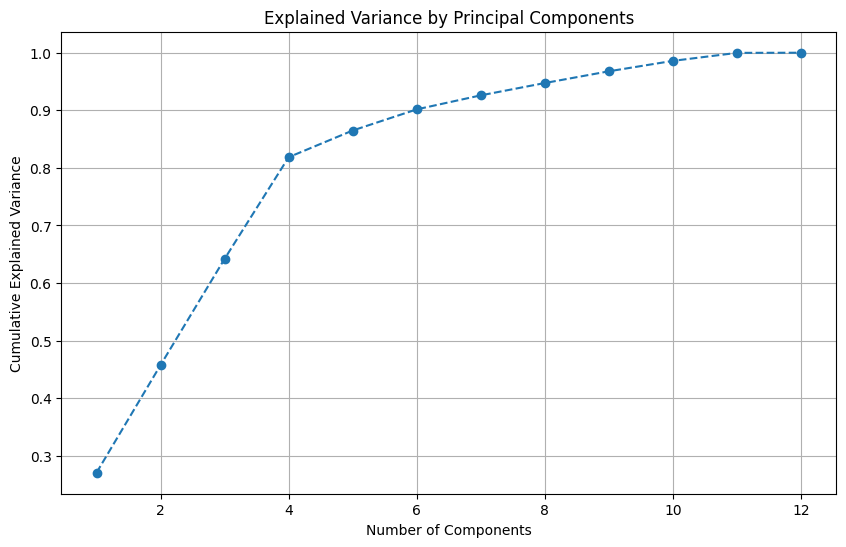

Selected number of components: 9
🏃 View run PCA with Logistic Regression at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/11/runs/fcae10e5348a4bc9a9f4d9336c47f36f
🧪 View experiment at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/11


In [31]:
#Experiment 5
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.decomposition import PCA
from sklearn.feature_selection import RFE
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder, LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix, classification_report, roc_auc_score, balanced_accuracy_score
import mlflow
import pandas as pd
import numpy as np
from mlflow.models import infer_signature
import matplotlib.pyplot as plt
import warnings

# Suppress warnings
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

# Set MLFlow experiment for PCA and Logistic Regression
mlflow.set_experiment("Pollution_LogisticRegression_PCA")

# Load and preprocess the data
if 'Air_Quality' not in df.columns:
    raise KeyError("The target column 'Air_Quality' is missing from the dataset.")

X = df.drop(columns=['Air_Quality'])
y = df['Air_Quality']

numeric_features = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_features = X.select_dtypes(include=['object']).columns.tolist()

numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler()),
    ('minmax', MinMaxScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

# Encode the target
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Apply preprocessing
preprocessed_pipeline = Pipeline([
    ('preprocessor', preprocessor)
])

X_train_preprocessed = preprocessed_pipeline.fit_transform(X_train)
X_test_preprocessed = preprocessed_pipeline.transform(X_test)

# PCA for dimensionality reduction
pca = PCA()
X_train_pca = pca.fit_transform(X_train_preprocessed)

# Scree plot
explained_variance_ratio = pca.explained_variance_ratio_
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance_ratio) + 1), np.cumsum(explained_variance_ratio), marker='o', linestyle='--')
plt.title('Explained Variance by Principal Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid()
plt.savefig("scree_plot.png")
plt.show()

# Select number of components that explain at least 95% variance
n_components = np.argmax(np.cumsum(explained_variance_ratio) >= 0.95) + 1
print(f"Selected number of components: {n_components}")

# Reduce dimensionality using selected number of components
pca = PCA(n_components=n_components)
X_train_pca = pca.fit_transform(X_train_preprocessed)
X_test_pca = pca.transform(X_test_preprocessed)

# Logistic Regression with PCA
logistic_model = LogisticRegression(max_iter=1000)
logistic_model.fit(X_train_pca, y_train)

# Predictions
y_pred = logistic_model.predict(X_test_pca)
y_pred_proba = logistic_model.predict_proba(X_test_pca)

# Evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
roc_auc = roc_auc_score(y_test, y_pred_proba, multi_class='ovr', average='weighted')
conf_matrix = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

# Log results in MLFlow
with mlflow.start_run(run_name="PCA with Logistic Regression"):
    mlflow.log_param("n_components", n_components)
    signature = infer_signature(X_train_pca, logistic_model.predict(X_train_pca))
    mlflow.sklearn.log_model(
        sk_model=logistic_model,
        artifact_path="Pollution_LogisticRegression_PCA_Model",
        signature=signature,
        input_example=X_train_pca
    )

    # Log metrics to MLFlow
    mlflow.log_metric("accuracy", accuracy)
    mlflow.log_metric("balanced_accuracy", balanced_accuracy)
    mlflow.log_metric("f1_score", f1)
    mlflow.log_metric("precision", precision)
    mlflow.log_metric("recall", recall)
    mlflow.log_metric("roc_auc", roc_auc)

    # Log the classification report as an artifact
    with open("classification_report_pca.txt", "w") as file:
        file.write(classification_rep)
    mlflow.log_artifact("classification_report_pca.txt")

    # Log the scree plot
    mlflow.log_artifact("scree_plot.png")

    # Flatten the confusion matrix
    flattened_conf_matrix = conf_matrix.flatten()
    for i, value in enumerate(flattened_conf_matrix):
        mlflow.log_metric(f"confusion_matrix_{i}", value)

**Experiment #6: Quality Prediction Workflow with Random Forest, Hyperparameter Tuning, and MLFlow Tracking**

---



In [32]:
#Experiment 6
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix, classification_report, roc_auc_score
import mlflow
import numpy as np
import pandas as pd
from mlflow.models import infer_signature
import warnings

# Suppress warnings
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

# Define custom experiment
mlflow.set_experiment("Pollution_CustomExperiment")

# Load and preprocess the data
if 'Air_Quality' not in df.columns:
    raise KeyError("The target column 'Air_Quality' is missing from the dataset.")

X = df.drop(columns=['Air_Quality'])
y = df['Air_Quality']

numeric_features = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_features = X.select_dtypes(include=['object']).columns.tolist()

numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

# Define the custom model pipeline
custom_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', RandomForestClassifier(random_state=42))
])

# Define hyperparameter grid
param_grid = {
    'classifier__n_estimators': [50, 100, 200],
    'classifier__max_depth': [None, 10, 20],
    'classifier__min_samples_split': [2, 5, 10],
    'classifier__min_samples_leaf': [1, 2, 4]
}

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Perform GridSearchCV
grid_search = GridSearchCV(custom_pipeline, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

# Best model and its score
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Log hyperparameter-tuned model and score
with mlflow.start_run(run_name="CustomExperiment"):
    mlflow.log_params(best_params)
    mlflow.log_metric("cv_best_accuracy", best_score)

    # Log the best model
    signature = infer_signature(X_train, best_model.predict(X_train))
    mlflow.sklearn.log_model(
        sk_model=best_model,
        artifact_path="Pollution_Custom_Model",
        signature=signature,
        input_example=X_train
    )

    # Evaluate the best model on test data
    y_pred = best_model.predict(X_test)
    y_pred_proba = best_model.predict_proba(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred, average='weighted')
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    roc_auc = roc_auc_score(y_test, y_pred_proba, multi_class='ovr', average='weighted')
    conf_matrix = confusion_matrix(y_test, y_pred)
    classification_rep = classification_report(y_test, y_pred)

    # Log metrics to MLFlow
    mlflow.log_metric("accuracy", accuracy)
    mlflow.log_metric("f1_score", f1)
    mlflow.log_metric("precision", precision)
    mlflow.log_metric("recall", recall)
    mlflow.log_metric("roc_auc", roc_auc)

    # Log the classification report as an artifact
    with open("classification_report_custom_experiment.txt", "w") as file:
        file.write(classification_rep)
    mlflow.log_artifact("classification_report_custom_experiment.txt")

    # Flatten the confusion matrix
    flattened_conf_matrix = conf_matrix.flatten()
    for i, value in enumerate(flattened_conf_matrix):
        mlflow.log_metric(f"confusion_matrix_{i}", value)

# Output results
print(f"Best Model: {best_model}")
print(f"Best Parameters: {best_params}")
print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"ROC AUC: {roc_auc}")
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(classification_rep)


🏃 View run CustomExperiment at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/15/runs/06c5c924cfcc43cd810d1e0f6578d6ef
🧪 View experiment at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/15
Best Model: Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['quality_id', 'factor_id',
                                                   'pollutant_id',
                                                   'Temperature_C',
                                                   'Humidity_%',
                                                   'P

**Experiment #7: Gradient Boosting Air Quality Prediction using Randomized Hyperparameter Tuning and MLFlow Logging**

In [33]:
#Experiment 7
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix, classification_report, roc_auc_score
import mlflow
from mlflow.models import infer_signature
import warnings

# Suppress warnings
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

# Define custom experiment
mlflow.set_experiment("Pollution_GradientBoosting_OptimizedExperiment")

# Load and preprocess the data
if 'Air_Quality' not in df.columns:
    raise KeyError("The target column 'Air_Quality' is missing from the dataset.")

X = df.drop(columns=['Air_Quality'])
y = df['Air_Quality']

numeric_features = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_features = X.select_dtypes(include=['object']).columns.tolist()

numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

# Define the Gradient Boosting Classifier pipeline
gb_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', GradientBoostingClassifier(random_state=42))
])

# Define hyperparameter grid for RandomizedSearchCV
param_grid = {
    'classifier__n_estimators': [50, 100, 200],
    'classifier__learning_rate': [0.05, 0.1, 0.2],
    'classifier__max_depth': [3, 5],
    'classifier__min_samples_split': [2, 5],
    'classifier__min_samples_leaf': [1, 2]
}

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Perform RandomizedSearchCV
random_search = RandomizedSearchCV(
    gb_pipeline, param_grid, n_iter=10, cv=3, scoring='accuracy', n_jobs=-1, random_state=42
)
random_search.fit(X_train, y_train)

# Best model and its score
best_model = random_search.best_estimator_
best_params = random_search.best_params_
best_score = random_search.best_score_

# Log hyperparameter-tuned model and score
with mlflow.start_run(run_name="GradientBoosting_OptimizedExperiment"):
    mlflow.log_params(best_params)
    mlflow.log_metric("cv_best_accuracy", best_score)

    # Log the best model
    signature = infer_signature(X_train, best_model.predict(X_train))
    mlflow.sklearn.log_model(
        sk_model=best_model,
        artifact_path="Pollution_GradientBoosting_Model",
        signature=signature,
        input_example=X_train
    )

    # Evaluate the best model on test data
    y_pred = best_model.predict(X_test)
    y_pred_proba = best_model.predict_proba(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred, average='weighted')
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    roc_auc = roc_auc_score(y_test, y_pred_proba, multi_class='ovr', average='weighted')
    conf_matrix = confusion_matrix(y_test, y_pred)
    classification_rep = classification_report(y_test, y_pred)

    # Log metrics to MLFlow
    mlflow.log_metric("accuracy", accuracy)
    mlflow.log_metric("f1_score", f1)
    mlflow.log_metric("precision", precision)
    mlflow.log_metric("recall", recall)
    mlflow.log_metric("roc_auc", roc_auc)

    # Log the classification report as an artifact
    with open("classification_report_gradient_boosting.txt", "w") as file:
        file.write(classification_rep)
    mlflow.log_artifact("classification_report_gradient_boosting.txt")

    # Flatten the confusion matrix
    flattened_conf_matrix = conf_matrix.flatten()
    for i, value in enumerate(flattened_conf_matrix):
        mlflow.log_metric(f"confusion_matrix_{i}", value)

# Output results
print(f"Best Model: {best_model}")
print(f"Best Parameters: {best_params}")
print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"ROC AUC: {roc_auc}")
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(classification_rep)


🏃 View run GradientBoosting_OptimizedExperiment at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/17/runs/bffca2024ada4e6891978fe971bc53dd
🧪 View experiment at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/17
Best Model: Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['quality_id', 'factor_id',
                                                   'pollutant_id',
                                                   'Temperature_C',
                                                   'Humidity_%',
                                 

**Meaningful F1-score plots to compare experiments and determine the best model.**

F1-score not found for experiment 'Pollution_LogReg_Pipeline_CV'.
F1-score not found for experiment 'Pollution_Feature_Selection'.


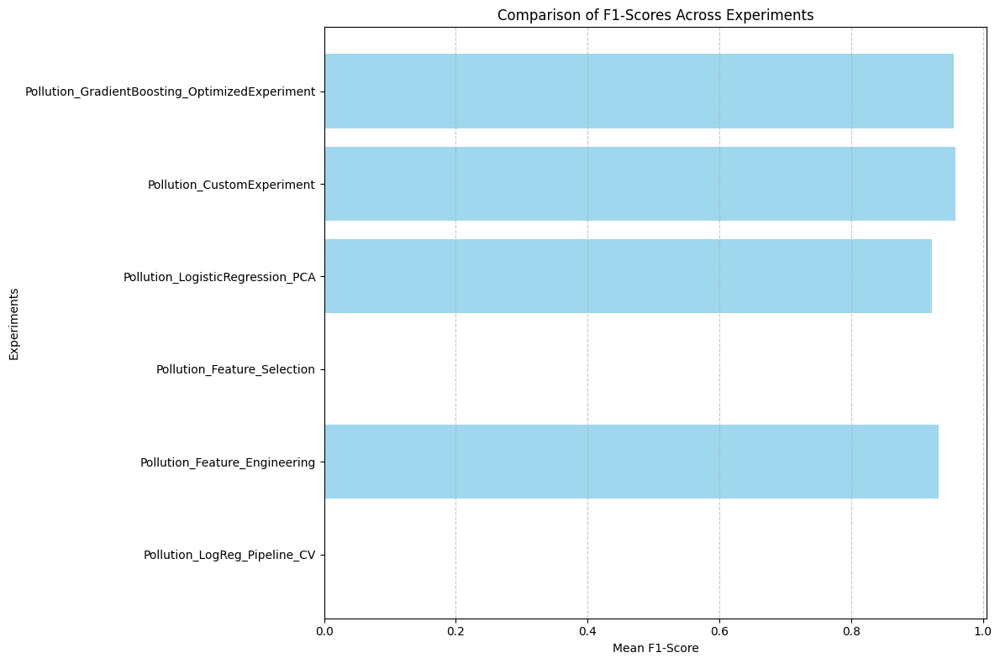

🏃 View run F1_Score_Comparison at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/17/runs/cfbfae759186417796d95cd48fb688fe
🧪 View experiment at: https://dagshub.com/Sheethal-123/Project.mlflow/#/experiments/17


In [34]:
import matplotlib.pyplot as plt
import mlflow
import pandas as pd

# Define experiment names for comparison
experiment_names = [
    "Pollution_LogReg_Pipeline_CV",
    "Pollution_Feature_Engineering",
    "Pollution_Feature_Selection",
    "Pollution_LogisticRegression_PCA",
    "Pollution_CustomExperiment",
    "Pollution_GradientBoosting_OptimizedExperiment"
]

# Initialize a dictionary to store results
experiment_results = {}

# Retrieve F1-scores from MLFlow
for experiment_name in experiment_names:
    experiment = mlflow.get_experiment_by_name(experiment_name)
    if experiment:
        experiment_id = experiment.experiment_id
        runs = mlflow.search_runs([experiment_id])
        if 'metrics.f1_score' in runs.columns:
            f1_scores = runs['metrics.f1_score'].dropna().values  # Ensure F1-scores exist
            mean_f1 = f1_scores.mean() if len(f1_scores) > 0 else 0
            std_f1 = f1_scores.std() if len(f1_scores) > 0 else 0
            experiment_results[experiment_name] = (mean_f1, std_f1)
        else:
            print(f"F1-score not found for experiment '{experiment_name}'.")
            experiment_results[experiment_name] = (0, 0)  # Default values for missing data
    else:
        print(f"Experiment '{experiment_name}' not found in MLFlow.")
        experiment_results[experiment_name] = (0, 0)  # Default values for missing experiment

# Prepare data for plotting
labels = list(experiment_results.keys())
mean_f1_scores = [result[0] for result in experiment_results.values()]
std_f1_scores = [result[1] for result in experiment_results.values()]

# Create the plot
plt.figure(figsize=(12, 8))
plt.barh(labels, mean_f1_scores, xerr=std_f1_scores, color='skyblue', alpha=0.8)
plt.xlabel("Mean F1-Score")
plt.ylabel("Experiments")
plt.title("Comparison of F1-Scores Across Experiments")
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()

# Save and display the plot
plt.savefig("f1_score_comparison_plot.png")
plt.show()

# Log the plot as an artifact in MLFlow
with mlflow.start_run(run_name="F1_Score_Comparison"):
    mlflow.log_artifact("f1_score_comparison_plot.png")

In [35]:
import joblib

# Save the model in the current working directory
joblib.dump(best_model, "final_model.pkl")
print("Model saved as 'final_model.pkl'")

Model saved as 'final_model.pkl'
